# Convolutional Neural Networks

## Project: Write an Algorithm for a Dog Identification App 

---

In this notebook, some template code has already been provided for you, and you will need to implement additional functionality to successfully complete this project. You will not need to modify the included code beyond what is requested. Sections that begin with **'(IMPLEMENTATION)'** in the header indicate that the following block of code will require additional functionality which you must provide. Instructions will be provided for each section, and the specifics of the implementation are marked in the code block with a 'TODO' statement. Please be sure to read the instructions carefully! 

> **Note**: Once you have completed all of the code implementations, you need to finalize your work by exporting the Jupyter Notebook as an HTML document. Before exporting the notebook to html, all of the code cells need to have been run so that reviewers can see the final implementation and output. You can then export the notebook by using the menu above and navigating to **File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question X'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut.  Markdown cells can be edited by double-clicking the cell to enter edit mode.

The rubric contains _optional_ "Stand Out Suggestions" for enhancing the project beyond the minimum requirements. If you decide to pursue the "Stand Out Suggestions", you should include the code in this Jupyter notebook.



---
### Why We're Here 

In this notebook, you will make the first steps towards developing an algorithm that could be used as part of a mobile or web app.  At the end of this project, your code will accept any user-supplied image as input.  If a dog is detected in the image, it will provide an estimate of the dog's breed.  If a human is detected, it will provide an estimate of the dog breed that is most resembling.  The image below displays potential sample output of your finished project (... but we expect that each student's algorithm will behave differently!). 

![Sample Dog Output](images/sample_dog_output.png)

In this real-world setting, you will need to piece together a series of models to perform different tasks; for instance, the algorithm that detects humans in an image will be different from the CNN that infers dog breed.  There are many points of possible failure, and no perfect algorithm exists.  Your imperfect solution will nonetheless create a fun user experience!

### The Road Ahead

We break the notebook into separate steps.  Feel free to use the links below to navigate the notebook.

* [Step 0](#step0): Import Datasets
* [Step 1](#step1): Detect Humans
* [Step 2](#step2): Detect Dogs
* [Step 3](#step3): Create a CNN to Classify Dog Breeds (from Scratch)
* [Step 4](#step4): Create a CNN to Classify Dog Breeds (using Transfer Learning)
* [Step 5](#step5): Write your Algorithm
* [Step 6](#step6): Test Your Algorithm

---
<a id='step0'></a>
## Step 0: Import Datasets

Make sure that you've downloaded the required human and dog datasets:
* Download the [dog dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/dogImages.zip).  Unzip the folder and place it in this project's home directory, at the location `/dogImages`. 

* Download the [human dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/lfw.zip).  Unzip the folder and place it in the home directory, at location `/lfw`.  

*Note: If you are using a Windows machine, you are encouraged to use [7zip](http://www.7-zip.org/) to extract the folder.*

In the code cell below, we save the file paths for both the human (LFW) dataset and dog dataset in the numpy arrays `human_files` and `dog_files`.

In [1]:
import numpy as np
from glob import glob

# load filenames for human and dog images
human_files = np.array(glob("lfw/*/*"))
dog_files = np.array(glob("dogImages/*/*/*"))

# print number of images in each dataset
print('There are %d total human images.' % len(human_files))
print('There are %d total dog images.' % len(dog_files))

There are 13233 total human images.
There are 8351 total dog images.


<a id='step1'></a>
## Step 1: Detect Humans

In this section, we use OpenCV's implementation of [Haar feature-based cascade classifiers](http://docs.opencv.org/trunk/d7/d8b/tutorial_py_face_detection.html) to detect human faces in images.  

OpenCV provides many pre-trained face detectors, stored as XML files on [github](https://github.com/opencv/opencv/tree/master/data/haarcascades).  We have downloaded one of these detectors and stored it in the `haarcascades` directory.  In the next code cell, we demonstrate how to use this detector to find human faces in a sample image.

Number of faces detected: 1


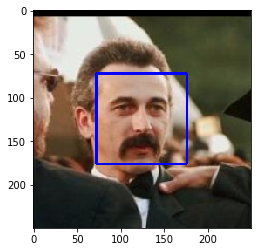

In [2]:
import cv2                
import matplotlib.pyplot as plt                        
%matplotlib inline                               

# extract pre-trained face detector
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')

# load color (BGR) image
img = cv2.imread(human_files[10])
# convert BGR image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# find faces in image
faces = face_cascade.detectMultiScale(gray)

# print number of faces detected in the image
print('Number of faces detected:', len(faces))

# get bounding box for each detected face
for (x,y,w,h) in faces:
    # add bounding box to color image
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    
# convert BGR image to RGB for plotting
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# display the image, along with bounding box
plt.imshow(cv_rgb)
plt.show()

Before using any of the face detectors, it is standard procedure to convert the images to grayscale.  The `detectMultiScale` function executes the classifier stored in `face_cascade` and takes the grayscale image as a parameter.  

In the above code, `faces` is a numpy array of detected faces, where each row corresponds to a detected face.  Each detected face is a 1D array with four entries that specifies the bounding box of the detected face.  The first two entries in the array (extracted in the above code as `x` and `y`) specify the horizontal and vertical positions of the top left corner of the bounding box.  The last two entries in the array (extracted here as `w` and `h`) specify the width and height of the box.

### Write a Human Face Detector

We can use this procedure to write a function that returns `True` if a human face is detected in an image and `False` otherwise.  This function, aptly named `face_detector`, takes a string-valued file path to an image as input and appears in the code block below.

In [3]:
# returns "True" if face is detected in image stored at img_path
def face_detector(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0

### (IMPLEMENTATION) Assess the Human Face Detector

__Question 1:__ Use the code cell below to test the performance of the `face_detector` function.  
- What percentage of the first 100 images in `human_files` have a detected human face?  
- What percentage of the first 100 images in `dog_files` have a detected human face? 

Ideally, we would like 100% of human images with a detected face and 0% of dog images with a detected face.  You will see that our algorithm falls short of this goal, but still gives acceptable performance.  We extract the file paths for the first 100 images from each of the datasets and store them in the numpy arrays `human_files_short` and `dog_files_short`.

__Answer:__ 
96% of human face were detected correctly, while 18% of dog was misclassified as human face

Human face detects : 96.0 %
Dog detects as human: 18.0 %


<Figure size 432x288 with 0 Axes>

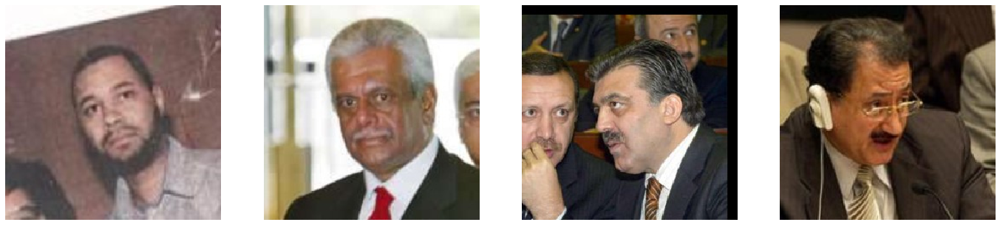

<Figure size 432x288 with 0 Axes>

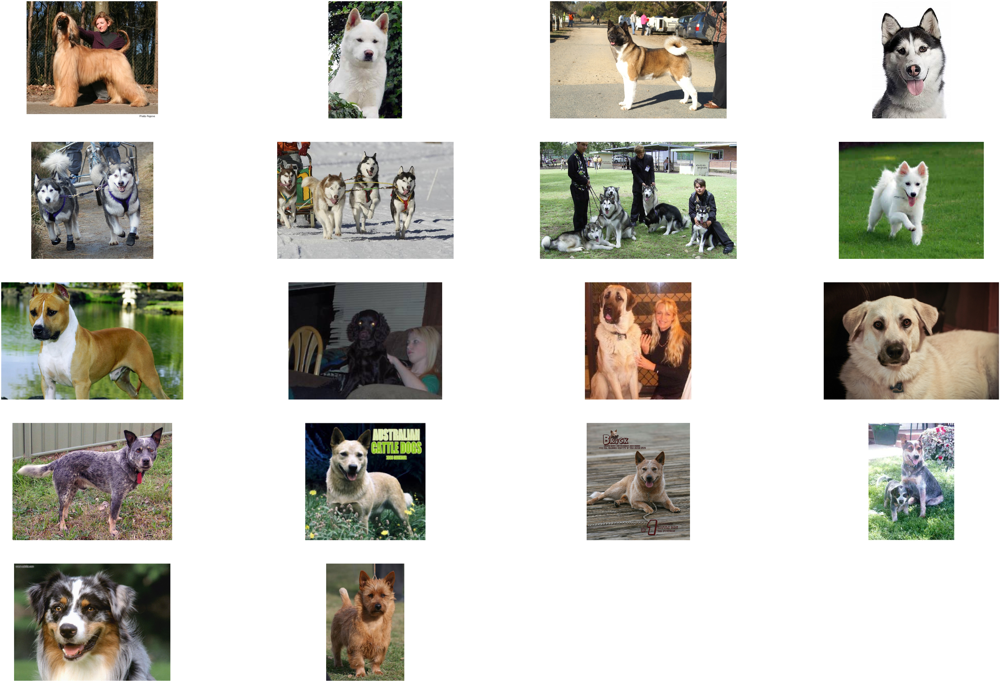

In [4]:
from tqdm import tqdm

human_files_short = human_files[:100]
dog_files_short = dog_files[:100]

#-#-# Do NOT modify the code above this line. #-#-#

## TODO: Test the performance of the face_detector algorithm 
## on the images in human_files_short and dog_files_short.

def visualize_img(img_path, countX = 4):
    fig = plt.figure()
    n_images = len(img_path)
    
    for i in range(n_images):
        ax = fig.add_subplot(np.ceil(n_images/float(countX)), countX, i + 1)
        img = cv2.imread(img_path[i])
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
#     fig.show()
    
    
    
def check_accurary(img_path, detector = face_detector, kind = 'dog'):
    true_detected = np.array([detector(path) for path in img_path])
    
    if (kind == 'human'):
        img = [path for i,path in enumerate(img_path, 0) if true_detected[i] == 0 ]
    else: img = [path for i,path in enumerate(img_path, 0) if true_detected[i] != 0 ]
    
    fig = plt.figure()
    n_images = len(img)
    
    visualize_img(img)
    return true_detected.sum()/len(img_path)

print("Human face detects : {} %".format(check_accurary(human_files_short, face_detector, 'human')*100))
print("Dog detects as human: {} %".format(check_accurary(dog_files_short, face_detector, 'dog')*100))


We suggest the face detector from OpenCV as a potential way to detect human images in your algorithm, but you are free to explore other approaches, especially approaches that make use of deep learning :).  Please use the code cell below to design and test your own face detection algorithm.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

In [ ]:
### (Optional) 
### TODO: Test performance of another face detection algorithm.
### Feel free to use as many code cells as needed.

---
<a id='step2'></a>
## Step 2: Detect Dogs

In this section, we use a [pre-trained model](http://pytorch.org/docs/master/torchvision/models.html) to detect dogs in images.  

### Obtain Pre-trained VGG-16 Model

The code cell below downloads the VGG-16 model, along with weights that have been trained on [ImageNet](http://www.image-net.org/), a very large, very popular dataset used for image classification and other vision tasks.  ImageNet contains over 10 million URLs, each linking to an image containing an object from one of [1000 categories](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a).  

In [5]:
import torch
import torchvision.models as models

# define VGG16 model
VGG16 = models.vgg16(pretrained=True)

# check if CUDA is available
use_cuda = torch.cuda.is_available()

# move model to GPU if CUDA is available
if use_cuda:
    VGG16 = VGG16.cuda()

Given an image, this pre-trained VGG-16 model returns a prediction (derived from the 1000 possible categories in ImageNet) for the object that is contained in the image.

### (IMPLEMENTATION) Making Predictions with a Pre-trained Model

In the next code cell, you will write a function that accepts a path to an image (such as `'dogImages/train/001.Affenpinscher/Affenpinscher_00001.jpg'`) as input and returns the index corresponding to the ImageNet class that is predicted by the pre-trained VGG-16 model.  The output should always be an integer between 0 and 999, inclusive.

Before writing the function, make sure that you take the time to learn  how to appropriately pre-process tensors for pre-trained models in the [PyTorch documentation](http://pytorch.org/docs/stable/torchvision/models.html).

In [7]:
from PIL import Image
import torchvision.transforms as transforms

# Set PIL to be tolerant of image files that are truncated.
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

def VGG16_predict(img_path):
    '''
    Use pre-trained VGG-16 model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        
    Returns:
        Index corresponding to VGG-16 model's prediction
    '''
    
    ## TODO: Complete the function.
    ## Load and pre-process an image from the given img_path
    ## Return the *index* of the predicted class for that image
    
    # mini-batches of 3-channel RGB images of shape (3 x H x W), 
    # where H and W are expected to be at least 224. The images 
    # have to be loaded in to a range of [0, 1] and then normalized 
    # using mean = [0.485, 0.456, 0.406] and std = [0.229, 0.224, 0.225]
    
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
    tf = transforms.Compose([transforms.Resize(224), transforms.CenterCrop(224), transforms.ToTensor(), normalize])   
    
    img = tf(Image.open(img_path)).unsqueeze(0)
    if use_cuda:
        img = img.cuda()
    
    predictor = VGG16(img)
   
    
    return predictor.argmax() # predicted class index

### (IMPLEMENTATION) Write a Dog Detector

While looking at the [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a), you will notice that the categories corresponding to dogs appear in an uninterrupted sequence and correspond to dictionary keys 151-268, inclusive, to include all categories from `'Chihuahua'` to `'Mexican hairless'`.  Thus, in order to check to see if an image is predicted to contain a dog by the pre-trained VGG-16 model, we need only check if the pre-trained model predicts an index between 151 and 268 (inclusive).

Use these ideas to complete the `dog_detector` function below, which returns `True` if a dog is detected in an image (and `False` if not).

In [8]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector(img_path):
    ## TODO: Complete the function.
    
    rs = VGG16_predict(img_path).cpu().numpy() #convert cuda instance to cpu -> numpy
    
    return (rs >= 151 and rs <= 268)

### (IMPLEMENTATION) Assess the Dog Detector

__Question 2:__ Use the code cell below to test the performance of your `dog_detector` function.  
- What percentage of the images in `human_files_short` have a detected dog?  
- What percentage of the images in `dog_files_short` have a detected dog?

__Answer:__ 
In VGG16 model, there no human was misclassified, whereas 95% of dog were detected correctly

Human detects as dog 0.0 %
Missed classified human as dog (if any):
Dog detects as dog 95.0 %
Missed classified dog (if any):


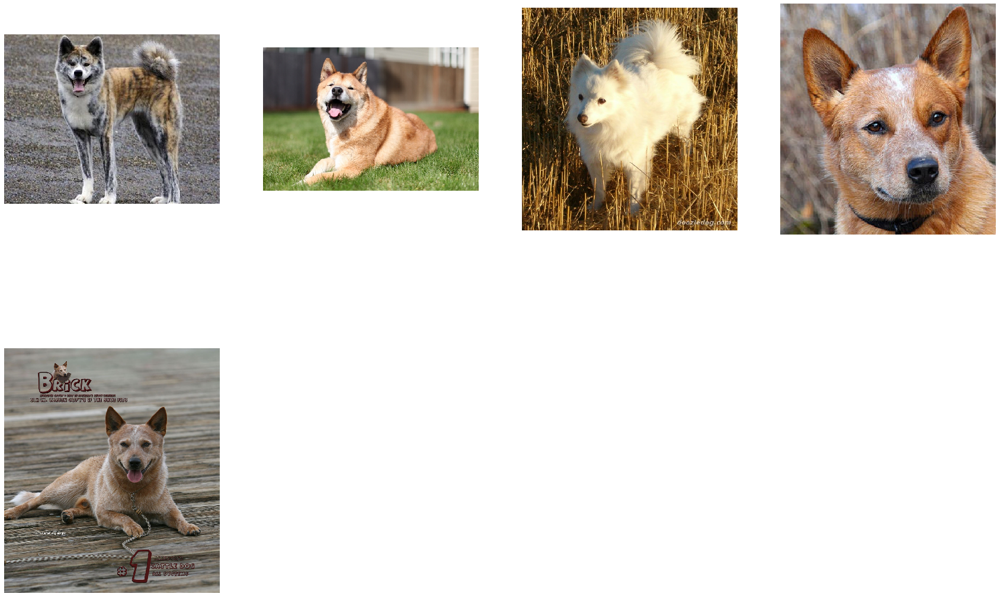

In [9]:
### TODO: Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.

dog = []
human = []
for dog_path, human_path in zip(dog_files_short, human_files_short):
    dog.append(dog_detector(dog_path)) 
    human.append(dog_detector(human_path)) 

img_hu = [path for i,path in enumerate(human_files_short, 0) if human[i]]
print("Human detects as dog {} %".format(len(img_hu)/len(human_files_short)*100))
print("Missed classified human as dog (if any):")
if (len(img_hu) > 0): visualize_img(img_hu)

img_dog = [path for i,path in enumerate(dog_files_short, 0) if ~dog[i]]    
print("Dog detects as dog {} %".format(100-len(img_dog)/len(dog_files_short)*100))
print("Missed classified dog (if any):")
if (len(dog) > 0): visualize_img(img_dog)

We suggest VGG-16 as a potential network to detect dog images in your algorithm, but you are free to explore other pre-trained networks (such as [Inception-v3](http://pytorch.org/docs/master/torchvision/models.html#inception-v3), [ResNet-50](http://pytorch.org/docs/master/torchvision/models.html#id3), etc).  Please use the code cell below to test other pre-trained PyTorch models.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

### Test with Inception-v3

In [10]:
### (Optional) 
### TODO: Report the performance of another pre-trained network.
### Feel free to use as many code cells as needed.

#define model
inception = models.inception_v3(pretrained=True)

#check cuda
if use_cuda:
    inception = inception.cuda()
    inception.eval()

In [11]:
def inception_predict(img_path):
    '''
    Use pre-trained Inception model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        
    Returns:
        Index corresponding to VGG-16 model's prediction
    '''
    
    ## TODO: Complete the function.
    ## Load and pre-process an image from the given img_path
    ## Return the *index* of the predicted class for that image
    
    # mini-batches of 3-channel RGB images of shape (3 x H x W), 
    # where H and W are expected to be at least 299. The images 
    # have to be loaded in to a range of [0, 1] and then normalized 
    # using mean = [0.485, 0.456, 0.406] and std = [0.229, 0.224, 0.225]
    
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
    tf = transforms.Compose([transforms.Resize(299), transforms.CenterCrop(299), transforms.ToTensor(), normalize])   
    
    img = tf(Image.open(img_path).convert('RGB')).unsqueeze(0)
    
    if use_cuda:
        img = img.cuda()
    with torch.no_grad():
        predictor = inception(img)
   
    
    return predictor.argmax() # predicted class index

In [12]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector_inception(img_path):
    ## TODO: Complete the function.
    
    rs = inception_predict(img_path).cpu().numpy() #convert cuda instance to cpu -> numpy
    
    return (rs >= 151 and rs <= 268)

Human detects as dog 0.0 %
Missed classified human as dog (if any):
Dog detects as dog 96.0 %
Missed classified dog (if any):


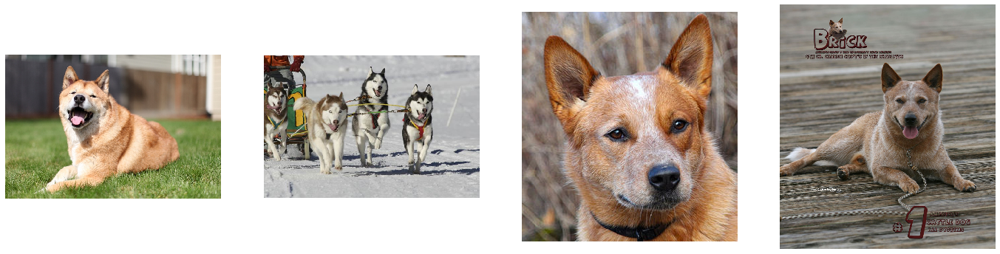

In [13]:
### TODO: Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.

dog = []
human = []
for dog_path, human_path in zip(dog_files_short, human_files_short):
    dog.append(dog_detector_inception(dog_path)) 
    human.append(dog_detector_inception(human_path)) 

img_hu = [path for i,path in enumerate(human_files_short, 0) if human[i]]
print("Human detects as dog {} %".format(len(img_hu)/len(human_files_short)*100))
print("Missed classified human as dog (if any):")
if (len(img_hu) > 0): visualize_img(img_hu)

img_dog = [path for i,path in enumerate(dog_files_short, 0) if ~dog[i]]    
print("Dog detects as dog {} %".format(100-len(img_dog)/len(dog_files_short)*100))
print("Missed classified dog (if any):")
if (len(dog) > 0): visualize_img(img_dog)

As for Inception-v3, the result was a bit ahead of VGG16 when dog was detected was 96% and no human was misclassified

### Test with ResNet-50  

In [14]:
### (Optional) 
### TODO: Report the performance of another pre-trained network.
### Feel free to use as many code cells as needed.

#define model
resnet = models.wide_resnet50_2(pretrained=True)

#check cuda
if use_cuda:
    resnet = resnet.cuda()
    resnet.eval()

In [15]:
def resnet_predict(img_path):
    '''
    Use pre-trained Inception model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        
    Returns:
        Index corresponding to VGG-16 model's prediction
    '''
    
    ## TODO: Complete the function.
    ## Load and pre-process an image from the given img_path
    ## Return the *index* of the predicted class for that image
    
    # mini-batches of 3-channel RGB images of shape (3 x H x W), 
    # where H and W are expected to be at least 224. The images 
    # have to be loaded in to a range of [0, 1] and then normalized 
    # using mean = [0.485, 0.456, 0.406] and std = [0.229, 0.224, 0.225]
    
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
    tf = transforms.Compose([transforms.Resize(224), transforms.CenterCrop(224), transforms.ToTensor(), normalize])   
    
    img = tf(Image.open(img_path).convert('RGB')).unsqueeze(0)
    
    if use_cuda:
        img = img.cuda()
    with torch.no_grad():
        predictor = resnet(img)
   
    
    return predictor.argmax() # predicted class index

In [16]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector_resnet(img_path):
    ## TODO: Complete the function.
    
    rs = resnet_predict(img_path).cpu().numpy() #convert cuda instance to cpu -> numpy
    
    return (rs >= 151 and rs <= 268)

Human detects as dog 2.0 %
Missed classified human as dog (if any):


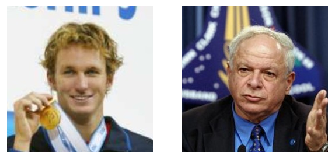

In [17]:
### TODO: Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.

dog = []
human = []
for dog_path, human_path in zip(dog_files_short, human_files_short):
    dog.append(dog_detector_resnet(dog_path)) 
    human.append(dog_detector_resnet(human_path)) 

img_hu = [path for i,path in enumerate(human_files_short, 0) if human[i]]
print("Human detects as dog {} %".format(len(img_hu)/len(human_files_short)*100))
print("Missed classified human as dog (if any):")
if (len(img_hu) > 0): visualize_img(img_hu)

Dog detects as dog 95.0 %
Missed classified dog (if any):


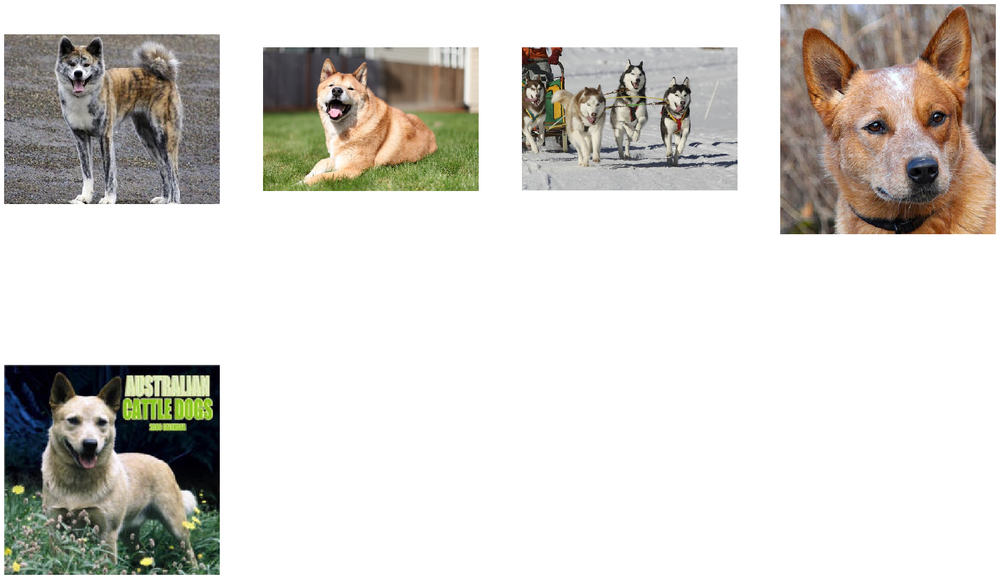

In [18]:
img_dog = [path for i,path in enumerate(dog_files_short, 0) if ~dog[i]]    
print("Dog detects as dog {} %".format(100-len(img_dog)/len(dog_files_short)*100))
print("Missed classified dog (if any):")
if (len(dog) > 0): visualize_img(img_dog)

ResNet yielded the nearly the worst when wrongly classifying 2 humans as dog

**Same pictures were misclassified in all 3 models**

---
<a id='step3'></a>
## Step 3: Create a CNN to Classify Dog Breeds (from Scratch)

Now that we have functions for detecting humans and dogs in images, we need a way to predict breed from images.  In this step, you will create a CNN that classifies dog breeds.  You must create your CNN _from scratch_ (so, you can't use transfer learning _yet_!), and you must attain a test accuracy of at least 10%.  In Step 4 of this notebook, you will have the opportunity to use transfer learning to create a CNN that attains greatly improved accuracy.

We mention that the task of assigning breed to dogs from images is considered exceptionally challenging.  To see why, consider that *even a human* would have trouble distinguishing between a Brittany and a Welsh Springer Spaniel.  

Brittany | Welsh Springer Spaniel
- | - 
<img src="images/Brittany_02625.jpg" width="100"> | <img src="images/Welsh_springer_spaniel_08203.jpg" width="200">

It is not difficult to find other dog breed pairs with minimal inter-class variation (for instance, Curly-Coated Retrievers and American Water Spaniels).  

Curly-Coated Retriever | American Water Spaniel
- | -
<img src="images/Curly-coated_retriever_03896.jpg" width="200"> | <img src="images/American_water_spaniel_00648.jpg" width="200">


Likewise, recall that labradors come in yellow, chocolate, and black.  Your vision-based algorithm will have to conquer this high intra-class variation to determine how to classify all of these different shades as the same breed.  

Yellow Labrador | Chocolate Labrador | Black Labrador
- | -
<img src="images/Labrador_retriever_06457.jpg" width="150"> | <img src="images/Labrador_retriever_06455.jpg" width="240"> | <img src="images/Labrador_retriever_06449.jpg" width="220">

We also mention that random chance presents an exceptionally low bar: setting aside the fact that the classes are slightly imabalanced, a random guess will provide a correct answer roughly 1 in 133 times, which corresponds to an accuracy of less than 1%.  

Remember that the practice is far ahead of the theory in deep learning.  Experiment with many different architectures, and trust your intuition.  And, of course, have fun!

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/stable/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dogImages/train`, `dogImages/valid`, and `dogImages/test`, respectively).  You may find [this documentation on custom datasets](http://pytorch.org/docs/stable/torchvision/datasets.html) to be a useful resource.  If you are interested in augmenting your training and/or validation data, check out the wide variety of [transforms](http://pytorch.org/docs/stable/torchvision/transforms.html?highlight=transform)!

In [19]:
import os
from torchvision import datasets
from PIL import ImageFile
from glob import glob

ImageFile.LOAD_TRUNCATED_IMAGES = True

### TODO: Write data loaders for training, validation, and test sets
## Specify appropriate transforms, and batch_sizes

min_resize = 224
min_crop = 224
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                std=[0.229, 0.224, 0.225])

input_dir = 'dogImages'
train_dir = 'train'
test_dir = 'test'
valid_dir = 'valid'

#transform
train_tf = transforms.Compose([transforms.Resize(min_resize),
                                       transforms.CenterCrop(min_crop),
                                       transforms.RandomHorizontalFlip(),
                                       transforms.RandomVerticalFlip(),
                                       transforms.RandomRotation(2020),
                                       transforms.ToTensor(),
                                       normalize])

test_tf = transforms.Compose([transforms.Resize(min_resize),
                                       transforms.CenterCrop(min_crop),
                                       transforms.ToTensor(),
                                       normalize])

valid_tf = test_tf = transforms.Compose([transforms.Resize(min_resize),
                                       transforms.CenterCrop(min_crop),
                                       transforms.ToTensor(),
                                       normalize])

#load datasets
train_dt = datasets.ImageFolder(input_dir + '/' + train_dir, transform=train_tf)
test_dt = datasets.ImageFolder(input_dir + '/' + test_dir, transform=test_tf)
valid_dt = datasets.ImageFolder(input_dir + '/' + valid_dir, transform=valid_tf)

print("Train data: {} images loaded".format(len(train_dt)))
print("Test data: {} images loaded".format(len(test_dt)))
print("Valid data: {} images loaded".format(len(valid_dt)))

loaders_scratch = {}
loaders_scratch[train_dir] = torch.utils.data.DataLoader(train_dt, batch_size=32, shuffle=True)
loaders_scratch[test_dir] = torch.utils.data.DataLoader(test_dt, batch_size=32)
loaders_scratch[valid_dir] = torch.utils.data.DataLoader(valid_dt, batch_size=32)

print("Total categories: {}".format(len(train_dt.classes)))
print(train_dt.classes)

Train data: 6680 images loaded
Test data: 836 images loaded
Valid data: 835 images loaded
Total categories: 133
['001.Affenpinscher', '002.Afghan_hound', '003.Airedale_terrier', '004.Akita', '005.Alaskan_malamute', '006.American_eskimo_dog', '007.American_foxhound', '008.American_staffordshire_terrier', '009.American_water_spaniel', '010.Anatolian_shepherd_dog', '011.Australian_cattle_dog', '012.Australian_shepherd', '013.Australian_terrier', '014.Basenji', '015.Basset_hound', '016.Beagle', '017.Bearded_collie', '018.Beauceron', '019.Bedlington_terrier', '020.Belgian_malinois', '021.Belgian_sheepdog', '022.Belgian_tervuren', '023.Bernese_mountain_dog', '024.Bichon_frise', '025.Black_and_tan_coonhound', '026.Black_russian_terrier', '027.Bloodhound', '028.Bluetick_coonhound', '029.Border_collie', '030.Border_terrier', '031.Borzoi', '032.Boston_terrier', '033.Bouvier_des_flandres', '034.Boxer', '035.Boykin_spaniel', '036.Briard', '037.Brittany', '038.Brussels_griffon', '039.Bull_terrier',

**Question 3:** Describe your chosen procedure for preprocessing the data. 
- How does your code resize the images (by cropping, stretching, etc)?  What size did you pick for the input tensor, and why?
- Did you decide to augment the dataset?  If so, how (through translations, flips, rotations, etc)?  If not, why not?


**Answer**:
* The images were cropped to 224x224 from the center, in order to match with the input tensor size of the transfer learning model, since almost all of them have input size of 224x224 pixels, except for Inception-v3 with 299x299 pixels.
* The training dataset was randomly flipped horizontally and vertically, and the rotated at 2020 degrees (or 220 degrees for short). It also underwent a normalizing process of mean = [0.485, 0.456, 0.406] and standard variation = [0.229, 0.224, 0.225].

### (IMPLEMENTATION) Model Architecture

Create a CNN to classify dog breed.  Use the template in the code cell below.

In [20]:
import torch.nn as nn
import torch.nn.functional as F

# define the CNN architecture
class Net(nn.Module):
    ### TODO: choose an architecture, and complete the class
    def __init__(self):
        super(Net, self).__init__()
        ## Define layers of a CNN
        #Input channels = 3, output channels = 16 (224x224x3)
        self.conv1 = torch.nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1)
        #Input channels = 16, output channels = 32 (112x112x16)
        self.conv2 = torch.nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1)
        #Input channels = 32, output channels = 64 (56x56x32)
        self.conv3 = torch.nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        #Input channels = 64, output channels = 128 (28x28x64) => (14x14x128)
        self.conv4 = torch.nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)        
        
        #Max pooling 
        self.pool = nn.MaxPool2d(2, 2)
        
        #Linear layer
        self.fc1 = torch.nn.Linear(14 * 14 * 128, 1000)
        self.fc2 = torch.nn.Linear(1000, 133)
        
        #Dropout
        self.dropout = nn.Dropout(p = 0.4)
        
        #Batch norm 
        self.batch_norm = nn.BatchNorm1d(num_features=1000)
        
    def forward(self, x):
        ## Define forward behavior
        x = F.relu(self.conv1(x))
        x = self.pool(x)
        
        x = F.relu(self.conv2(x))
        x = self.pool(x)
        
        x = F.relu(self.conv3(x))
        x = self.pool(x)
        
        x = F.relu(self.conv4(x))
        x = self.pool(x)
        
        #Reshape data to input to the input layer of the neural net
        #Size changes from (14, 14, 128) to (1, 25088)
        #Recall that the -1 infers this dimension from the other given dimension
        
        x = x.view(-1, 14 * 14 *128)
        
        #Dropout layer
        x = self.dropout(x)
        #Hidden layer
        x = F.relu(self.batch_norm(self.fc1(x)))
        #Dropout layer
        x = self.dropout(x)
        #Hidden layer
        x = self.fc2(x)
        
        return x

#-#-# You do NOT have to modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()

In [21]:
print(model_scratch)

Net(
  (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=25088, out_features=1000, bias=True)
  (fc2): Linear(in_features=1000, out_features=133, bias=True)
  (dropout): Dropout(p=0.4, inplace=False)
  (batch_norm): BatchNorm1d(1000, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
)


__Question 4:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  

__Answer:__ 
* The CNN architecture is basically a feature extractor
* The feature extractor consists of 4 CNN layers, where each has a ReLU and a MaxPooling2D to convert all negative pixels values to 0 and reduce the parameter of layers by taking the maximum value
* The details for input size at each layer is as follows:

First layer: 224x224x3

Second layer: 112x112x16

Third layer: 56x56x32

Forth layer: 28x28x64, output 14x14x128

* After the CNN layers, 2 Dropout layer with probality of 0.4 are introduced beside with linear function to convert 14x14x128 -> 1000 -> 133






### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/stable/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/stable/optim.html).  Save the chosen loss function as `criterion_scratch`, and the optimizer as `optimizer_scratch` below.

In [24]:
import torch.optim as optim

learning_rate = 0.01
### TODO: select loss function
criterion_scratch = nn.CrossEntropyLoss()

### TODO: select optimizer
optimizer_scratch = optim.SGD(model_scratch.parameters(), lr=learning_rate)

### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_scratch.pt'`.

In [40]:
# the following import is required for training to be robust to truncated images
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

def train(n_epochs, loaders, model, optimizer, criterion, use_cuda, save_path):
    """returns trained model"""
    # initialize tracker for minimum validation loss
    valid_loss_min = np.Inf 
    
    for epoch in range(1, n_epochs+1):
        # initialize variables to monitor training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        
        ###################
        # train the model #
        ###################
        model.train()
        for batch_idx, (data, target) in enumerate(loaders['train']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## find the loss and update the model parameters accordingly
            ## record the average training loss, using something like
            ## train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
            
            #Set the parameter gradients to zero
            optimizer.zero_grad()
            
            #Forward pass, backward pass, optimize
            output = model(data)
            loss = criterion(output, target)
            loss.backward()
            optimizer.step()
            
            train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
        ######################    
        # validate the model #
        ######################
        model.eval()
        for batch_idx, (data, target) in enumerate(loaders['valid']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## update the average validation loss
            val_output = model(data)
            val_loss = criterion(val_output, target)
            valid_loss = valid_loss + ((1 / (batch_idx + 1)) * (val_loss.data - valid_loss))
            
        # print training/validation statistics 
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))
        
        ## TODO: save the model if validation loss has decreased
        if valid_loss <= valid_loss_min:
            print('Saving  ...')
            torch.save(model.state_dict(), save_path)
            valid_loss_min = valid_loss
        else:
            print()
            
    # return trained model
    return model


# train the model
model_scratch = train(50, loaders_scratch, model_scratch, optimizer_scratch, 
                      criterion_scratch, use_cuda, 'model_scratch.pt')

# load the model that got the best validation accuracy
model_scratch.load_state_dict(torch.load('model_scratch.pt'))

Epoch: 1 	Training Loss: 3.268501 	Validation Loss: 3.989241
Saving  ...
Epoch: 2 	Training Loss: 3.239452 	Validation Loss: 3.658303
Saving  ...
Epoch: 3 	Training Loss: 3.184953 	Validation Loss: 3.744174

Epoch: 4 	Training Loss: 3.155644 	Validation Loss: 3.951157

Epoch: 5 	Training Loss: 3.120999 	Validation Loss: 3.701491

Epoch: 6 	Training Loss: 3.080171 	Validation Loss: 3.781493

Epoch: 7 	Training Loss: 3.026851 	Validation Loss: 3.612906
Saving  ...
Epoch: 8 	Training Loss: 2.999551 	Validation Loss: 3.681474

Epoch: 9 	Training Loss: 2.948540 	Validation Loss: 3.547491
Saving  ...
Epoch: 10 	Training Loss: 2.914404 	Validation Loss: 3.823301

Epoch: 11 	Training Loss: 2.893044 	Validation Loss: 3.648147

Epoch: 12 	Training Loss: 2.833305 	Validation Loss: 3.647682

Epoch: 13 	Training Loss: 2.813368 	Validation Loss: 3.608994

Epoch: 14 	Training Loss: 2.784027 	Validation Loss: 3.641557

Epoch: 15 	Training Loss: 2.741534 	Validation Loss: 3.596529

Epoch: 16 	Training 

<All keys matched successfully>

In [41]:
model_scratch.load_state_dict(torch.load('model_scratch.pt'))

<All keys matched successfully>

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images.  Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 10%.

In [42]:
def test(loaders, model, criterion, use_cuda):

    # monitor test loss and accuracy
    test_loss = 0.
    correct = 0.
    total = 0.

    model.eval()
    for batch_idx, (data, target) in enumerate(loaders['test']):
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the loss
        loss = criterion(output, target)
        # update average test loss 
        test_loss = test_loss + ((1 / (batch_idx + 1)) * (loss.data - test_loss))
        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]
        # compare predictions to true label
        correct += np.sum(np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy())
        total += data.size(0)
            
    print('Test Loss: {:.6f}\n'.format(test_loss))

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))

# call test function    
test(loaders_scratch, model_scratch, criterion_scratch, use_cuda)

Test Loss: 3.247653


Test Accuracy: 22% (187/836)


---
<a id='step4'></a>
## Step 4: Create a CNN to Classify Dog Breeds (using Transfer Learning)

You will now use transfer learning to create a CNN that can identify dog breed from images.  Your CNN must attain at least 60% accuracy on the test set.

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/master/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dogImages/train`, `dogImages/valid`, and `dogImages/test`, respectively). 

If you like, **you are welcome to use the same data loaders from the previous step**, when you created a CNN from scratch.

In [43]:
## TODO: Specify data loaders
loaders_transfer = loaders_scratch

### (IMPLEMENTATION) Model Architecture

Use transfer learning to create a CNN to classify dog breed.  Use the code cell below, and save your initialized model as the variable `model_transfer`.

In [44]:
import torchvision.models as models
import torch.nn as nn

## TODO: Specify model architecture 
model_transfer = models.wide_resnet50_2(pretrained=True)

In [45]:
print(model_transfer)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), strid

)


In [46]:
print(model_transfer.fc)

Linear(in_features=2048, out_features=1000, bias=True)


In [47]:
for param in model_transfer.parameters():
    param.requires_grad = False

model_transfer.fc = torch.nn.Linear(2048, 133, bias = True)

if use_cuda:
    model_transfer = model_transfer.cuda()

__Question 5:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  Describe why you think the architecture is suitable for the current problem.

__Answer:__ 
* Since VGG16 was introduced before, so I give Resnet-50 a try. In this task, a pre-trained Resnet-50 is implemented.
* Because the result of Resnet-50 in task 2 was so promising, and we do not have such a large dataset
* To start with, the last layer (Linear layer) is modified to match with the output size of 133, and all the pameters of feature extractor are deactivated, this is to make sure the parameters of the classifier get backprograted

### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/master/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/master/optim.html).  Save the chosen loss function as `criterion_transfer`, and the optimizer as `optimizer_transfer` below.

In [48]:
learning_rate = 0.01
criterion_transfer = nn.CrossEntropyLoss()
optimizer_transfer = optim.SGD(model_transfer.parameters(), lr=learning_rate)

### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_transfer.pt'`.

In [49]:
# train the model
n_epochs = 50
model_transfer = train(n_epochs, loaders_transfer, model_transfer, optimizer_transfer, criterion_transfer, use_cuda, 'model_transfer.pt')


Epoch: 1 	Training Loss: 4.703357 	Validation Loss: 4.328568
Saving  ...
Epoch: 2 	Training Loss: 4.307672 	Validation Loss: 3.809695
Saving  ...
Epoch: 3 	Training Loss: 3.952916 	Validation Loss: 3.375762
Saving  ...
Epoch: 4 	Training Loss: 3.657096 	Validation Loss: 2.963298
Saving  ...
Epoch: 5 	Training Loss: 3.385907 	Validation Loss: 2.622719
Saving  ...
Epoch: 6 	Training Loss: 3.180646 	Validation Loss: 2.358067
Saving  ...
Epoch: 7 	Training Loss: 3.002851 	Validation Loss: 2.157923
Saving  ...
Epoch: 8 	Training Loss: 2.846548 	Validation Loss: 1.957267
Saving  ...
Epoch: 9 	Training Loss: 2.709133 	Validation Loss: 1.832606
Saving  ...
Epoch: 10 	Training Loss: 2.597773 	Validation Loss: 1.673612
Saving  ...
Epoch: 11 	Training Loss: 2.480909 	Validation Loss: 1.566728
Saving  ...
Epoch: 12 	Training Loss: 2.402752 	Validation Loss: 1.452014
Saving  ...
Epoch: 13 	Training Loss: 2.299877 	Validation Loss: 1.376895
Saving  ...
Epoch: 14 	Training Loss: 2.250105 	Validation 

In [50]:
# load the model that got the best validation accuracy (uncomment the line below)
model_transfer.load_state_dict(torch.load('model_transfer.pt'))

<All keys matched successfully>

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images. Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 60%.

In [51]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.705896


Test Accuracy: 83% (695/836)


### (IMPLEMENTATION) Predict Dog Breed with the Model

Write a function that takes an image path as input and returns the dog breed (`Affenpinscher`, `Afghan hound`, etc) that is predicted by your model.  

In [52]:
### TODO: Write a function that takes a path to an image as input
### and returns the dog breed that is predicted by the model.

# list of class names by index, i.e. a name can be accessed like class_names[0]
class_names = [item[4:].replace("_", " ") for item in train_dt.classes]

def predict_breed_transfer(img_path):
    # load the image and return the predicted breed
    
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
    tf = transforms.Compose([transforms.Resize(224), transforms.CenterCrop(224), transforms.ToTensor(), normalize])   
    
    img = tf(Image.open(img_path)).unsqueeze(0)
    
    if use_cuda:
        img = img.cuda()
        
    
    model_transfer.eval()
    output = model_transfer(img)
    # convert output probabilities to predicted class
    pred = output.data.max(1, keepdim=True)[1]
    # compare predictions to true label
    
    return class_names[np.squeeze(pred.cpu().numpy())]

---
<a id='step5'></a>
## Step 5: Write your Algorithm

Write an algorithm that accepts a file path to an image and first determines whether the image contains a human, dog, or neither.  Then,
- if a __dog__ is detected in the image, return the predicted breed.
- if a __human__ is detected in the image, return the resembling dog breed.
- if __neither__ is detected in the image, provide output that indicates an error.

You are welcome to write your own functions for detecting humans and dogs in images, but feel free to use the `face_detector` and `dog_detector` functions developed above.  You are __required__ to use your CNN from Step 4 to predict dog breed.  

Some sample output for our algorithm is provided below, but feel free to design your own user experience!

![Sample Human Output](images/sample_human_output.png)


### (IMPLEMENTATION) Write your Algorithm

In [58]:
### TODO: Write your algorithm.
### Feel free to use as many code cells as needed.

dog_string = 'I guess you are a \n'
human_string = 'You look like a ... \n'
cant_detect_string = "Sorry I don't know who you are or what it is \nCome back next time when the system is upgraded"


def run_app(img_path):
    ## handle cases for a human face, dog, and neither
    if (face_detector(img_path)):
        title = 'Hello, human!'
        pred = predict_breed_transfer(img_path)
        output_string = human_string + pred
    elif (dog_detector(img_path)):
        title = 'Hi, there'
        pred = predict_breed_transfer(img_path)
        output_string = dog_string + pred
    else:
        title = 'Hi'
        output_string = cant_detect_string 

    
    plt.title(title + '\n' + output_string)
    plt.imshow(Image.open(img_path))
    plt.axis('off')
    plt.show()
    

---
<a id='step6'></a>
## Step 6: Test Your Algorithm

In this section, you will take your new algorithm for a spin!  What kind of dog does the algorithm think that _you_ look like?  If you have a dog, does it predict your dog's breed accurately?  If you have a cat, does it mistakenly think that your cat is a dog?

### (IMPLEMENTATION) Test Your Algorithm on Sample Images!

Test your algorithm at least six images on your computer.  Feel free to use any images you like.  Use at least two human and two dog images.  

__Question 6:__ Is the output better than you expected :) ?  Or worse :( ?  Provide at least three possible points of improvement for your algorithm.

__Answer:__ 
* Increase dog_detector's accuracy, so predict_breed_transfer can work well on the data. One of the dog whose breed could not be detected in my example below, since dog_detector do not work. This dog is also misclassified in both VGG16 and Resnet-50
* Detect multiple breeds at a time in one image, this can be done by using YOLO-3 for object detection to detect dog in image first, then using predict_breed_transfer to get breeds
* In the same manner, detect humans and dogs in one image and make prediction
* Try with a such large epoch number
* Bigger dataset also helps

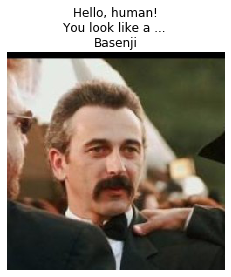

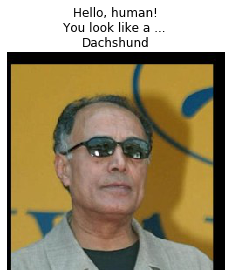

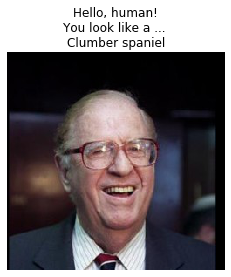

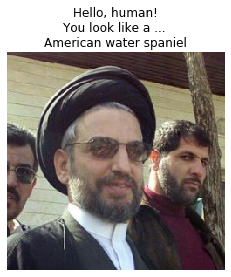

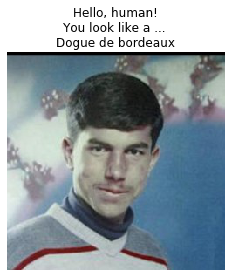

...

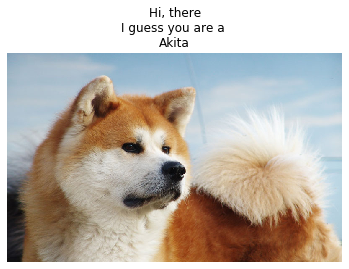

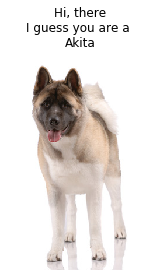

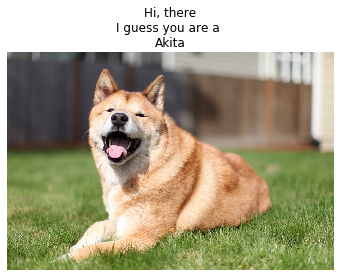

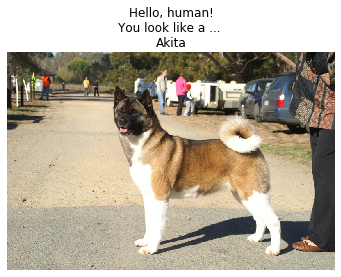

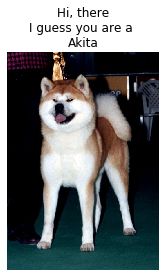

In [63]:
## TODO: Execute your algorithm from Step 6 on
## at least 6 images on your computer.
## Feel free to use as many code cells as needed.

## suggested code, below
for file in np.hstack((human_files[10:20], dog_files[20:30])):
    run_app(file)

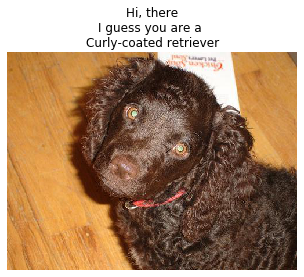

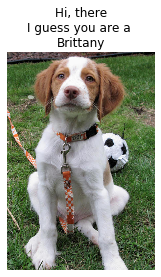

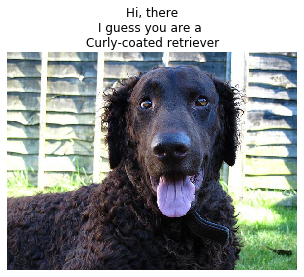

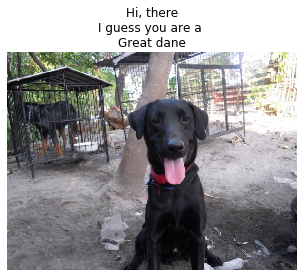

In [65]:
new_files = np.array(glob("images/*"))
for file in new_files[:4]:
    run_app(file)